## Introduction 


# COVID-19

   * Coronaviruses deisease (COVID-19) infectious disease caused by the SARS-CoV-2 virus.  
   * Most people infected with the virus will experience mild to moderate respiratory illness and recover without requiring special treatment. However, some will become seriously ill and require medical attention. Older people and those with underlying medical conditions like cardiovascular disease, diabetes, chronic respiratory disease, or cancer are more likely to develop serious illness. Anyone can get sick with COVID-19 and become seriously ill or die at any age. 
   * The best way to prevent and slow down transmission is to be well informed about the disease and how the virus spreads. Protect yourself and others from infection by staying at least 1 metre apart from others, wearing a properly fitted mask, and washing your hands or using an alcohol-based rub frequently. Get vaccinated when it’s your turn and follow local guidance.
   * The virus can spread from an infected person’s mouth or nose in small liquid particles when they cough, sneeze, speak, sing or breathe. These particles range from larger respiratory droplets to smaller aerosols. It is important to practice respiratory etiquette, for example by coughing into a flexed elbow, and to stay home and self-isolate until you recover if you feel unwell.

# Objective of the Project

   * The objective of this project is to study the COVID-19 outbreak with helpful visulization, which will help we better understand the process of pandemic. It will also perform predictions and forcasting in order to study the impact and the spread of COVID in the future. 

## References and Acknowledgements
**Data:**
* [Novel Coronavirus (COVID-19) Cases, provided by JHU CSSE](https://github.com/CSSEGISandData/COVID-19)

* [COVID19 Global Forecasting (Week 1)](https://www.kaggle.com/c/covid19-global-forecasting-week-1)

* [Novel Corona Virus 2019 Dataset](https://www.kaggle.com/sudalairajkumar/novel-corona-virus-2019-dataset)

* [COVID-19 Complete Dataset (Updated every 24hrs)](https://www.kaggle.com/imdevskp/corona-virus-report)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/covid_2

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive/covid_2


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np
import pandas as pd

import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
pio.templates.default = "plotly_dark"
from plotly.subplots import make_subplots
import folium 
from folium import plugins
from tqdm.notebook import tqdm as tqdm
import matplotlib.pyplot as plt


from pathlib import Path
data_dir = Path('/content/drive/MyDrive/covid_2')

import os
os.listdir(data_dir)

import warnings
warnings.filterwarnings('ignore')

In [ ]:
data = pd.read_csv(data_dir/'train.csv',parse_dates=['Date'])
data.head()

,Id,Province/State,Country/Region,Lat,Long,Date,ConfirmedCases,Fatalities
0,1,NaN,Afghanistan,33.0,65.0,2020-01-22,0.0,0.0
1,2,NaN,Afghanistan,33.0,65.0,2020-01-23,0.0,0.0
2,3,NaN,Afghanistan,33.0,65.0,2020-01-24,0.0,0.0
3,4,NaN,Afghanistan,33.0,65.0,2020-01-25,0.0,0.0
4,5,NaN,Afghanistan,33.0,65.0,2020-01-26,0.0,0.0


In [ ]:
cleaned_data = pd.read_csv('/content/drive/MyDrive/covid_2/covid_19_clean_complete.csv', parse_dates=['Date'])
cleaned_data.head()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
0,NaN,Afghanistan,33.93911,67.709953,2020-01-22,0,0,0,0,Eastern Mediterranean
1,NaN,Albania,41.15330,20.168300,2020-01-22,0,0,0,0,Europe
2,NaN,Algeria,28.03390,1.659600,2020-01-22,0,0,0,0,Africa
3,NaN,Andorra,42.50630,1.521800,2020-01-22,0,0,0,0,Europe
4,NaN,Angola,-11.20270,17.873900,2020-01-22,0,0,0,0,Africa


# Preprocessing

## Cleaning Data

In [ ]:
# cases 
cases = ['Confirmed', 'Deaths', 'Recovered', 'Active']

# Active Case = confirmed - deaths - recovered
cleaned_data['Active'] = cleaned_data['Confirmed'] - cleaned_data['Deaths'] - cleaned_data['Recovered']

# filling missing values 
cleaned_data[['Province/State']] = cleaned_data[['Province/State']].fillna('')
cleaned_data[cases] = cleaned_data[cases].fillna(0)

cleaned_data.head()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
0,,Afghanistan,33.93911,67.709953,2020-01-22,0,0,0,0,Eastern Mediterranean
1,,Albania,41.15330,20.168300,2020-01-22,0,0,0,0,Europe
2,,Algeria,28.03390,1.659600,2020-01-22,0,0,0,0,Africa
3,,Andorra,42.50630,1.521800,2020-01-22,0,0,0,0,Europe
4,,Angola,-11.20270,17.873900,2020-01-22,0,0,0,0,Africa


The cleaned data from [COVID-19 Complete Dataset (Updated every 24hrs)](https://www.kaggle.com/imdevskp/corona-virus-report) is used for visualizations.

**lets just see Confirmed , Deaths , Recovered abd Active in world wide in all over Country/Region and lets dig deeper into the top 5 Country/Region **

In [ ]:
# Creating a dataframe with total no of cases for every country
confirmiedcases = pd.DataFrame(cleaned_data.groupby('Country/Region')['Confirmed'].sum())
confirmiedcases['Country/Region'] = confirmiedcases.index
confirmiedcases.index = np.arange(1,188)

Deathcases = pd.DataFrame(cleaned_data.groupby('Country/Region')['Deaths'].sum())
Deathcases['Country/Region'] = Deathcases.index
Deathcases.iodex = np.arange(1,188)

Recoveredcases = pd.DataFrame(cleaned_data.groupby('Country/Region')['Recovered'].sum())
Recoveredcases['Country/Region'] = Recoveredcases.index
Recoveredcases.iodex = np.arange(1,188)

Activecases = pd.DataFrame(cleaned_data.groupby('Country/Region')['Active'].sum())
Activecases['Country/Region'] = Activecases.index
Activecases.iodex = np.arange(1,188)

global_Activecases = Activecases[['Country/Region','Active']]
global_Deathcases = Deathcases[['Country/Region','Deaths']]
global_Recoveredcases = Recoveredcases[['Country/Region','Recovered']]
global_confirmiedcases = confirmiedcases[['Country/Region','Confirmed']]

fig = px.bar(global_confirmiedcases.sort_values('Confirmed',ascending=False)[:20][::-1],x='Confirmed',y='Country/Region',title='Confirmed Cases Worldwide',text='Confirmed', height=900, orientation='h')
fig.show()

fig = px.bar(global_Deathcases.sort_values('Deaths',ascending=False)[:20][::-1],x='Deaths',y='Country/Region',title='Deaths Cases Worldwide',text='Deaths', height=900, orientation='h')
fig.show()

fig = px.bar(global_Recoveredcases.sort_values('Recovered',ascending=False)[:20][::-1],x='Recovered',y='Country/Region',title='Recovered Cases Worldwide',text='Recovered', height=900, orientation='h')
fig.show()

fig = px.bar(global_Activecases.sort_values('Active',ascending=False)[:20][::-1],x='Active',y='Country/Region',title='Active Cases Worldwide',text='Active', height=900, orientation='h')
fig.show()

**so by we can we can upderstand that**

* US is the most Confirmed , Deaths , Recovered and having Active people, which is 5 times more than the second country
* followed by  Brazil , United Kingdom ,Russia, India  in top 4 places and then the rest of the Countries 
* so lets make visualizations accordingly to the above result 

In [ ]:
date_c = cleaned_data.groupby('Date')['Confirmed','Deaths','Recovered','Active'].sum().reset_index()


from plotly.subplots import make_subplots
fig = make_subplots(rows=1, cols=4, subplot_titles=("Comfirmed", "Deaths", "Recovered",'Active'))

trace1 = go.Scatter(
                x=date_c['Date'],
                y=date_c['Confirmed'],
                name="Confirmed",
                line_color='orange',
                mode='lines+markers',
                opacity=0.8)
trace2 = go.Scatter(
                x=date_c['Date'],
                y=date_c['Deaths'],
                name="Deaths",
                line_color='red',
                mode='lines+markers',
                opacity=0.8)

trace3 = go.Scatter(
                x=date_c['Date'],
                y=date_c['Recovered'],
                name="Recovered",
                mode='lines+markers',
                line_color='green',
                opacity=0.8)

trace4 = go.Scatter(
                x=date_c['Date'],
                y=date_c['Active'],
                name="Active",
                line_color='blue',
                mode='lines+markers',
                opacity=0.8)

fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 1, 2)
fig.append_trace(trace3, 1, 3)
fig.append_trace(trace4, 1, 4)
fig.update_layout(template="plotly_dark",title_text = '<b>Global Spread of the Coronavirus Over Time </b>',
                  font=dict(family="Arial, Balto, Courier New, Droid Sans",color='white'))
fig.show()

* the adove is visual is the Global Spread of the COVID-19 in all over time 
* the Comfirmed id cases are more than 16M and Deaths is more than 600K
* the Recovered is more tha 10M and the active is nearly 6M

Next thing to do is to get the top five of the countries with most cases, and study them in details

In [ ]:
grouped_us = cleaned_data[cleaned_data['Country/Region'] == "US"].reset_index()
grouped_us_date = grouped_us.groupby('Date')['Date', 'Confirmed', 'Deaths','Recovered','Active'].sum().reset_index()

grouped_UK = cleaned_data[cleaned_data['Country/Region'] == "United Kingdom"].reset_index()
grouped_UK_date = grouped_UK.groupby('Date')['Date', 'Confirmed', 'Deaths','Recovered','Active'].sum().reset_index()

grouped_Brazil = cleaned_data[cleaned_data['Country/Region'] == "Brazil"].reset_index()
grouped_Brazil_date = grouped_Brazil.groupby('Date')['Date', 'Confirmed', 'Deaths','Recovered','Active'].sum().reset_index()

grouped_Russia = cleaned_data[cleaned_data['Country/Region'] == "Russia"].reset_index()
grouped_Russia_date = grouped_Russia.groupby('Date')['Date', 'Confirmed', 'Deaths','Recovered','Active'].sum().reset_index()

grouped_India = cleaned_data[cleaned_data['Country/Region'] == "India"].reset_index()
grouped_India_date = grouped_India.groupby('Date')['Date', 'Confirmed', 'Deaths','Recovered','Active'].sum().reset_index()

grouped_rest = cleaned_data[~cleaned_data['Country/Region'].isin(['US', 'United Kingdom', 'Brazil', 'Russia', 'India'])].reset_index()
grouped_rest_date = grouped_rest.groupby('Date')['Date', 'Confirmed', 'Deaths','Recovered','Active'].sum().reset_index()

## US

In [ ]:
fig = make_subplots(rows=1, cols=4, subplot_titles=("Comfirmed", "Deaths", "Recovered",'Active'))

trace1 = go.Scatter(x=grouped_us_date['Date'],y=grouped_us_date['Confirmed'],name="Confirmed",line_color='orange',mode='lines+markers',opacity=0.8)
trace2 = go.Scatter(x=grouped_us_date['Date'],y=grouped_us_date['Deaths'],name="Deaths",line_color='red',mode='lines+markers',opacity=0.8)
trace3 = go.Scatter(x=grouped_us_date['Date'],y=grouped_us_date['Recovered'],name="Recovered",mode='lines+markers',line_color='green',opacity=0.8)
trace4 = go.Scatter(x=grouped_us_date['Date'],y=grouped_us_date['Active'],name="Active",line_color='blue',mode='lines+markers',opacity=0.8)

fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 1, 2)
fig.append_trace(trace3, 1, 3)
fig.append_trace(trace4, 1, 4)
fig.update_layout(template="plotly_dark",title_text = '<b>Spread of the Coronavirus Over Time in US (TOP 1)</b>',
                  font=dict(family="Arial, Balto, Courier New, Droid Sans",color='white'))
fig.show()




In [ ]:
# create map and display it
latitude = 40
longitude = -100
world_map = folium.Map(location=[latitude, longitude], zoom_start=3.5,tiles='Stamen Toner')

for lat, lon, Confirmed,Deaths,Recovered,name in zip(grouped_us['Lat'], grouped_us['Long'], grouped_us['Confirmed'],grouped_us['Deaths'],grouped_us['Recovered'], grouped_us['Country/Region']):
    folium.CircleMarker([lat, lon],
                        radius=10,
                        popup = ('<strong>Country</strong>: ' + str(name).capitalize() + '<br>'
                                '<strong>Confirmed Cases</strong>: ' + str(Confirmed) + '<br>'
                                '<strong>Recovered Cases</strong>: ' + str(Recovered) +'<br>'
                                '<strong>Deaths Cases</strong>: ' + str(Deaths) +'<br>'),
                        color='red',
                        
                        fill_color='red',
                        fill_opacity=0.7 ).add_to(world_map)
world_map

* There have now been more than 400M cases in China, and the death toll has reached 148,011.


## UK

In [ ]:
fig = make_subplots(rows=1, cols=4, subplot_titles=("Comfirmed", "Deaths", "Recovered",'Active'))

trace1 = go.Scatter(x=grouped_UK_date['Date'],y=grouped_UK_date['Confirmed'],name="Confirmed",line_color='orange',mode='lines+markers',opacity=0.8)
trace2 = go.Scatter(x=grouped_UK_date['Date'],y=grouped_UK_date['Deaths'],name="Deaths",line_color='red',mode='lines+markers',opacity=0.8)
trace3 = go.Scatter(x=grouped_UK_date['Date'],y=grouped_UK_date['Recovered'],name="Recovered",mode='lines+markers',line_color='green',opacity=0.8)
trace4 = go.Scatter(x=grouped_UK_date['Date'],y=grouped_UK_date['Active'],name="Active",line_color='blue',mode='lines+markers',opacity=0.8)

fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 1, 2)
fig.append_trace(trace3, 1, 3)
fig.append_trace(trace4, 1, 4)
fig.update_layout(template="plotly_dark",title_text = '<b>Global Spread of the Coronavirus Over Time in UK (TOP 2)</b>',
                  font=dict(family="Arial, Balto, Courier New, Droid Sans",color='white'))
fig.show()



In [ ]:
# create map and display it
latitude = 32.2078
longitude = -64.7505
world_map = folium.Map(location=[latitude, longitude], zoom_start=3.5,tiles='Stamen Toner')

for lat, lon, Confirmed,Deaths,Recovered,name in zip(grouped_UK['Lat'], grouped_UK['Long'], grouped_UK['Confirmed'],grouped_UK['Deaths'],grouped_UK['Recovered'], grouped_UK['Country/Region']):
    folium.CircleMarker([lat, lon],
                        radius=10,
                        popup = ('<strong>Country</strong>: ' + str(name).capitalize() + '<br>'
                                '<strong>Confirmed Cases</strong>: ' + str(Confirmed) + '<br>'
                                '<strong>Recovered Cases</strong>: ' + str(Recovered) +'<br>'
                                '<strong>Deaths Cases</strong>: ' + str(Deaths) +'<br>'),
                        color='red',
                        
                        fill_color='red',
                        fill_opacity=0.7 ).add_to(world_map)
world_map

## Brazil

In [ ]:
fig = make_subplots(rows=1, cols=4, subplot_titles=("Comfirmed", "Deaths", "Recovered",'Active'))

trace1 = go.Scatter(x=grouped_Brazil_date['Date'],y=grouped_Brazil_date['Confirmed'],name="Confirmed",line_color='orange',mode='lines+markers',opacity=0.8)
trace2 = go.Scatter(x=grouped_Brazil_date['Date'],y=grouped_Brazil_date['Deaths'],name="Deaths",line_color='red',mode='lines+markers',opacity=0.8)
trace3 = go.Scatter(x=grouped_Brazil_date['Date'],y=grouped_Brazil_date['Recovered'],name="Recovered",mode='lines+markers',line_color='green',opacity=0.8)
trace4 = go.Scatter(x=grouped_Brazil_date['Date'],y=grouped_Brazil_date['Active'],name="Active",line_color='blue',mode='lines+markers',opacity=0.8)

fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 1, 2)
fig.append_trace(trace3, 1, 3)
fig.append_trace(trace4, 1, 4)
fig.update_layout(template="plotly_dark",title_text = '<b>Global Spread of the Coronavirus Over Time in Brazil (TOP 3)</b>',
                  font=dict(family="Arial, Balto, Courier New, Droid Sans",color='white'))
fig.show()

## Russia

In [ ]:
fig = make_subplots(rows=1, cols=4, subplot_titles=("Comfirmed", "Deaths", "Recovered",'Active'))

trace1 = go.Scatter(x=grouped_Russia_date['Date'],y=grouped_Russia_date['Confirmed'],name="Confirmed",line_color='orange',mode='lines+markers',opacity=0.8)
trace2 = go.Scatter(x=grouped_Russia_date['Date'],y=grouped_Russia_date['Deaths'],name="Deaths",line_color='red',mode='lines+markers',opacity=0.8)
trace3 = go.Scatter(x=grouped_Russia_date['Date'],y=grouped_Russia_date['Recovered'],name="Recovered",mode='lines+markers',line_color='green',opacity=0.8)
trace4 = go.Scatter(x=grouped_Russia_date['Date'],y=grouped_Russia_date['Active'],name="Active",line_color='blue',mode='lines+markers',opacity=0.8)

fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 1, 2)
fig.append_trace(trace3, 1, 3)
fig.append_trace(trace4, 1, 4)
fig.update_layout(template="plotly_dark",title_text = '<b>Global Spread of the Coronavirus Over Time in Russia (TOP 4)</b>',
                  font=dict(family="Arial, Balto, Courier New, Droid Sans",color='white'))
fig.show()

## India

In [ ]:
fig = make_subplots(rows=1, cols=4, subplot_titles=("Comfirmed", "Deaths", "Recovered",'Active'))

trace1 = go.Scatter(x=grouped_India_date['Date'],y=grouped_India_date['Confirmed'],name="Confirmed",line_color='orange',mode='lines+markers',opacity=0.8)
trace2 = go.Scatter(x=grouped_India_date['Date'],y=grouped_India_date['Deaths'],name="Deaths",line_color='red',mode='lines+markers',opacity=0.8)
trace3 = go.Scatter(x=grouped_India_date['Date'],y=grouped_India_date['Recovered'],name="Recovered",mode='lines+markers',line_color='green',opacity=0.8)
trace4 = go.Scatter(x=grouped_India_date['Date'],y=grouped_India_date['Active'],name="Active",line_color='blue',mode='lines+markers',opacity=0.8)

fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 1, 2)
fig.append_trace(trace3, 1, 3)
fig.append_trace(trace4, 1, 4)
fig.update_layout(template="plotly_dark",title_text = '<b>Global Spread of the Coronavirus Over Time in India (TOP 5)</b>',
                  font=dict(family="Arial, Balto, Courier New, Droid Sans",color='white'))
fig.show()

## REST OF THE WORLD 

In [ ]:
fig = make_subplots(rows=1, cols=4, subplot_titles=("Comfirmed", "Deaths", "Recovered",'Active'))

trace1 = go.Scatter(x=grouped_rest_date['Date'],y=grouped_rest_date['Confirmed'],name="Confirmed",line_color='orange',mode='lines+markers',opacity=0.8)
trace2 = go.Scatter(x=grouped_rest_date['Date'],y=grouped_rest_date['Deaths'],name="Deaths",line_color='red',mode='lines+markers',opacity=0.8)
trace3 = go.Scatter(x=grouped_rest_date['Date'],y=grouped_rest_date['Recovered'],name="Recovered",mode='lines+markers',line_color='green',opacity=0.8)
trace4 = go.Scatter(x=grouped_rest_date['Date'],y=grouped_rest_date['Active'],name="Active",line_color='blue',mode='lines+markers',opacity=0.8)

fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 1, 2)
fig.append_trace(trace3, 1, 3)
fig.append_trace(trace4, 1, 4)
fig.update_layout(template="plotly_dark",title_text = '<b>Global Spread of the Coronavirus Over Time in REST OF ALL OTHER </b>',
                  font=dict(family="Arial, Balto, Courier New, Droid Sans",color='white'))
fig.show()



In [ ]:
world_map_rest = folium.Map(location=[10, -10], zoom_start=2.5,tiles='Stamen Toner')

for lat, lon, Confirmed,Deaths,Recovered,name in zip(grouped_rest['Lat'], grouped_rest['Long'], grouped_rest['Confirmed'],grouped_rest['Deaths'],grouped_rest['Recovered'], grouped_rest['Country/Region']):
    folium.CircleMarker([lat, lon],
                        radius=7,
                        color='red',
                        
                        fill_color='red',
                        fill_opacity=0.7 ).add_to(world_map_rest)
world_map_rest

In [ ]:
# create map and display it
latitude = 10
longitude = -20
world_map = folium.Map(location=[latitude, longitude], zoom_start=3.5,tiles='Stamen Toner')

for lat, lon, Confirmed,Deaths,Recovered,name in zip(grouped_rest['Lat'], grouped_rest['Long'], grouped_rest['Confirmed'],grouped_rest['Deaths'],grouped_UK['Recovered'], grouped_rest['Country/Region']):
    folium.CircleMarker([lat, lon],
                        radius=10,
                        popup = ('<strong>Country</strong>: ' + str(name).capitalize() + '<br>'
                                '<strong>Confirmed Cases</strong>: ' + str(Confirmed) + '<br>'
                                '<strong>Recovered Cases</strong>: ' + str(Recovered) +'<br>'
                                '<strong>Deaths Cases</strong>: ' + str(Deaths) +'<br>'),
                        color='red',
                        
                        fill_color='red',
                        fill_opacity=0.7 ).add_to(world_map)
world_map

## Comparisions

**How about comparing the cases to better assess the situation**

In [ ]:
temp = cleaned_data.groupby('Date')['Recovered', 'Deaths', 'Active'].sum().reset_index()
temp = temp.melt(id_vars="Date", value_vars=['Recovered', 'Deaths', 'Active'],
                 var_name='case', value_name='count')


fig = px.area(temp, x="Date", y="count", color='case',
             title='Cases over time: Area Plot', color_discrete_sequence = ['cyan', 'red', 'orange'])
fig.show()

* Active cases rising up completely all together leaving recoveries way behind and deaths also staring to increase and might see a big rise if the trend continues.


Taking US out of the equation to see the effects elsewhere.

In [ ]:
rest = cleaned_data[cleaned_data['Country/Region'] != 'US']
rest_grouped = rest.groupby('Date')['Recovered', 'Deaths', 'Active'].sum().reset_index()

temp = rest_grouped.melt(id_vars="Date", value_vars=['Recovered', 'Deaths', 'Active'],
                 var_name='case', value_name='count')


fig = px.area(temp, x="Date", y="count", color='case',
             title='Cases - Rest of the World: Area Plot', color_discrete_sequence = ['cyan', 'red', 'orange'])
fig.show()

## Mortality and Recovery Rates¶

**It is worth seeing these stats as well. It might have a story for sure.**

In [ ]:
cleaned_latest = cleaned_data[cleaned_data['Date'] == max(cleaned_data['Date'])]
flg = cleaned_latest.groupby('Country/Region')['Confirmed', 'Deaths', 'Recovered', 'Active'].sum().reset_index()

flg['mortalityRate'] = round((flg['Deaths']/flg['Confirmed'])*100, 2)
temp = flg[flg['Confirmed']>100]
temp = temp.sort_values('mortalityRate', ascending=False)

fig = px.bar(temp.sort_values(by="mortalityRate", ascending=False)[:10][::-1],
             x = 'mortalityRate', y = 'Country/Region', 
             title='Deaths per 100 Confirmed Cases', text='mortalityRate', height=800, orientation='h',
             color_discrete_sequence=['darkred']
            )
fig.show()

## COVID-19: Spread Over Time

In [ ]:
# new data frame with confirmed and deanth 
formated_gdf = cleaned_data.groupby(['Date', 'Country/Region'])['Confirmed', 'Deaths'].max()
formated_gdf = formated_gdf.reset_index()
formated_gdf['Date'] = pd.to_datetime(formated_gdf['Date'])
formated_gdf['Date'] = formated_gdf['Date'].dt.strftime('%m/%d/%Y')
formated_gdf['size'] = formated_gdf['Confirmed'].pow(0.3)

fig = px.scatter_geo(formated_gdf, locations="Country/Region", locationmode='country names', 
                     color="Confirmed", size='size', hover_name="Country/Region", 
                     range_color= [0, 1500], 
                     projection="natural earth", animation_frame="Date", 
                     title='COVID-19: Spread Over Time', color_continuous_scale="portland")
# fig.update(layout_coloraxis_showscale=False)
fig.show()

## COVID-19: Deaths Over Time

In [ ]:
formated_gdf = cleaned_data.groupby(['Date', 'Country/Region'])['Confirmed', 'Deaths'].max()
formated_gdf = formated_gdf.reset_index()
formated_gdf['Date'] = pd.to_datetime(formated_gdf['Date'])
formated_gdf['Date'] = formated_gdf['Date'].dt.strftime('%m/%d/%Y')
formated_gdf['size'] = formated_gdf['Deaths'].pow(0.3)

fig = px.scatter_geo(formated_gdf, locations="Country/Region", locationmode='country names', 
                     color="Deaths", size='size', hover_name="Country/Region", 
                     range_color= [0, 100], 
                     projection="natural earth", animation_frame="Date", 
                     title='COVID-19: Deaths Over Time', color_continuous_scale="peach")
# fig.update(layout_coloraxis_showscale=False)
fig.show()

## COVID-19: Active Cases Over Time

In [ ]:
formated_gdf = cleaned_data.groupby(['Date', 'Country/Region'])['Confirmed', 'Deaths', 'Active', 'Recovered'].max()
formated_gdf = formated_gdf.reset_index()
formated_gdf['Date'] = pd.to_datetime(formated_gdf['Date'])
formated_gdf['Date'] = formated_gdf['Date'].dt.strftime('%m/%d/%Y')
formated_gdf['size'] = formated_gdf['Active'].pow(0.3)
formated_gdf['size'].fillna(formated_gdf['size'].mean(),inplace=True)

fig = px.scatter_geo(formated_gdf, locations="Country/Region", locationmode='country names', 
                     color="Active", size='size', hover_name="Country/Region", 
                     range_color= [0, 1000], 
                     projection="natural earth", animation_frame="Date", 
                     title='COVID-19: Active Cases Over Time', color_continuous_scale="portland")
fig.update(layout_coloraxis_showscale=False)
fig.show()

# Modeling <a id="3"></a>

Now, I will demonstrate how sales can be forecasted using various methods, namely: **naive approach, moving average, Holt linear, exponential smoothing, ARIMA, and Prophet**

## Train/Val split <a id="3.1"></a>

First, we need to create miniature training and validation sets to train and validate our models. I will take the last 90 days as the validation data and the 300 days before that as the training data. We need to predict the sales in the validation data using the sales in the training data.

In [ ]:
train_dataset = pd.read_csv('/content/drive/MyDrive/covid_2/time_series_covid_19_confirmed.csv')
drop_clo = ['Province/State','Country/Region','Lat','Long']
train_dataset=train_dataset.drop(drop_clo,axis=1)
datewise= list(train_dataset.columns)
val_dataset = train_dataset[datewise[-30:]]

In [ ]:
train_dataset.drop(columns = train_dataset.columns[:100], axis = 1, inplace = True)
train_dataset

,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20,5/10/20,...,5/20/21,5/21/21,5/22/21,5/23/21,5/24/21,5/25/21,5/26/21,5/27/21,5/28/21,5/29/21
0,2291,2470,2705,2895,3225,3393,3564,3781,4042,4403,...,64575,65080,65486,65728,66275,66903,67743,68366,69130,70111
1,782,789,795,803,820,832,842,850,856,868,...,132118,132153,132176,132209,132215,132229,132244,132264,132285,132297
2,4154,4295,4474,4648,4838,4997,5182,5369,5558,5723,...,126156,126434,126651,126860,127107,127361,127646,127926,128198,128456
3,745,747,748,750,751,751,752,752,754,755,...,13569,13569,13569,13569,13569,13664,13671,13682,13693,13693
4,30,35,35,35,36,36,36,43,43,45,...,31661,31909,32149,32441,32623,32933,33338,33607,33944,34180
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
271,270,270,271,271,271,271,288,288,288,288,...,4809,4941,5119,5275,5404,5931,6086,6356,6396,6908
272,353,353,353,362,371,374,375,375,375,375,...,304532,304968,305201,305201,305777,306334,306795,306795,307569,307838
273,7,10,10,12,21,25,25,34,34,51,...,6613,6632,6649,6658,6662,6670,6688,6696,6723,6731
274,109,119,124,137,138,146,153,167,252,267,...,92754,92920,93106,93201,93279,93428,93627,93947,94430,94751


* Below are the sales from three sample data points. I will use these samples to demonstrate the working of the models.

**now we will see the Forcasting of all the important attribute like <font size=4 style="color:red"> Confirmed</font>,<font size=4 style="color:red"> Deaths</font>,<font size=4 style="color:red"> Recovered</font> **

# time_series_covid_19_confirmed

**lets see the sample data points**

In [ ]:
fig = make_subplots(rows=3, cols=1)

fig.add_trace(
    go.Scatter(x=np.arange(70), mode='lines+markers', y=train_dataset.loc[0].values, marker=dict(color="dodgerblue"), showlegend=False,),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(70, 100), y=val_dataset.loc[0].values, mode='lines+markers', marker=dict(color="darkorange"), showlegend=False,),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(70), mode='lines+markers', y=train_dataset.loc[1].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(70, 100), y=val_dataset.loc[1].values, mode='lines+markers', marker=dict(color="darkorange"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(70), mode='lines+markers', y=train_dataset.loc[2].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(70, 100), y=val_dataset.loc[2].values, mode='lines+markers', marker=dict(color="darkorange"), showlegend=False),
    row=3, col=1
)

fig.update_layout(height=1200, width=800, title_text="Train (blue) vs. Validation (orange) sales")
fig.show()

## Naive approach <a id="3.2"></a>


The first approach is the very simple **naive approach**. It simply forecasts the next day's sales as the current day's sales. The model can be summarized as:

<img src="https://i.imgur.com/r8wjrzk.png" width="120px">

In the above equation, y<sub>t+1</sub> is the predicted value for the next day's sales and y<sub>t</sub> is today's sales. The model predicts tomorrow's sales as today's sales. Now let us see how this simple model performs on our miniature dataset. The training data is in <font color="blue">blue</font>, validation data in <font color="darkorange">orange</font>, and predictions in <font color="green">green</font>.

In [ ]:
predictions = []
for i in range(len(val_dataset.columns)):
    if i == 0:
        predictions.append(train_dataset[train_dataset.columns[-1]].values)
    else:
        predictions.append(val_dataset[val_dataset.columns[i-1]].values)
    
predictions = np.transpose(np.array([row.tolist() for row in predictions]))
error_naive = np.linalg.norm(predictions[:3] - val_dataset.values[:3])/len(predictions[0])

In [ ]:
error_naive

706.8731978069177

In [ ]:
pred_1 = predictions[0]
pred_2 = predictions[1]
pred_3 = predictions[2]

fig = make_subplots(rows=3, cols=1)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[0].values, marker=dict(color="dodgerblue"),
               name="Train"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[0].values, mode='lines', marker=dict(color="darkorange"),
               name="Val"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_1, mode='lines', marker=dict(color="seagreen"),
               name="Pred"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[1].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[1].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_2, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[2].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[2].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_3, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=3, col=1
)

fig.update_layout(height=1200, width=800, title_text="Naive approach")
fig.show()

We can see that the forecasts made by the naive approach are not that accurate and it is to be expected of such a simple model. We need more complex models that use several time stamps to make forecasts.

## Moving average <a id="3.3"></a>

The **moving average** method is more complex than the naive approach. It calculates the mean sales over the previous 30 days and forecasts that as the next day's sales. This method takes the previous 30 timesteps into consideration, and is therefore less prone to short term fluctuations than the naive approach. The model can be summarized as:

<img src="https://i.imgur.com/5uJvt7H.png" width="220px">

In the above equation, y<sub>t+1</sub> is tomorrow's sales. On the right hand side, all the sales for the previous 30 days are added up and divided by 30 to find the average. This forms the model's prediction, y<sub>t+1</sub>. Now let us see how this new model performs on our miniature dataset. The training data is in <font color="blue">blue</font>, validation data in <font color="darkorange">orange</font>, and predictions in <font color="green">green</font>.

In [ ]:
predictions = []
for i in range(len(val_dataset.columns)):
    if i == 0:
        predictions.append(np.mean(train_dataset[train_dataset.columns[-30:]].values, axis=1))
    if i < 31 and i > 0:
        predictions.append(0.5 * (np.mean(train_dataset[train_dataset.columns[-30+i:]].values, axis=1) + \
                                  np.mean(predictions[:i], axis=0)))
    if i > 31:
        predictions.append(np.mean([predictions[:i]], axis=1))
    
predictions = np.transpose(np.array([row.tolist() for row in predictions]))
error_avg = np.linalg.norm(predictions[:3] - val_dataset.values[:3])/len(predictions[0])

In [ ]:
error_avg

1143.2245925751486

In [ ]:
pred_1 = predictions[0]
pred_2 = predictions[1]
pred_3 = predictions[2]

fig = make_subplots(rows=3, cols=1)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[0].values, marker=dict(color="dodgerblue"),
               name="Train"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[0].values, mode='lines', marker=dict(color="darkorange"),
               name="Val"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_1, mode='lines', marker=dict(color="seagreen"),
               name="Pred"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[1].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[1].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_2, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[2].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[2].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_3, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=3, col=1
)

fig.update_layout(height=1200, width=800, title_text="Moving average")
fig.show()

## Holt linear <a id="3.4"></a>

The **Holt linear** is completely different from the first two methods. Holt linear attempts to capture the high-level trends in the time series data and fits the data with a straight line. The method can be summarized as follows:

### Forecast, level, and trend equations respectively

<img src="https://i.imgur.com/MHgcgGo.png" width="180px">
<img src="https://i.imgur.com/3ImRHEO.png" width="300px">
<img src="https://i.imgur.com/XExnvMX.png" width="300px">


In the above equations, $\alpha$ and $\beta$ are constants which can be configured. The values *l<sub>t</sub>* and *b<sub>t</sub>* represent the **level** and **trend** values repsectively. The trend value is the slope of the linear forecast function and the level value is the *y*-intercept of the linear forecast function. The slope and *y*-intercept values are continuously updated using the second and third update equations. Finally, the slope and *y*-intercept are used to calculate the forecast *y<sub>t+h</sub>* (in equation 1), which is *h* time steps ahead of the current time step. Now let us see how this model performs on our miniature dataset. The training data is in <font color="blue">blue</font>, validation data in <font color="darkorange">orange</font>, and predictions in <font color="green">green</font>.

In [ ]:
from statsmodels.tsa.api import ExponentialSmoothing, SimpleExpSmoothing, Holt

predictions = []
for row in tqdm(train_dataset[train_dataset.columns[-30:]].values[:3]):
    fit = Holt(row).fit(smoothing_level = 0.3, smoothing_slope = 0.01)
    predictions.append(fit.forecast(30))
predictions = np.array(predictions).reshape((-1, 30))
error_holt = np.linalg.norm(predictions - val_dataset.values[:len(predictions)])/len(predictions[0])

  0%|          | 0/3 [00:00<?, ?it/s]

In [ ]:
error_holt

3890.510852991292

In [ ]:
pred_1 = predictions[0]
pred_2 = predictions[1]
pred_3 = predictions[2]

fig = make_subplots(rows=3, cols=1)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[0].values, marker=dict(color="dodgerblue"),
               name="Train"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[0].values, mode='lines', marker=dict(color="darkorange"),
               name="Val"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_1, mode='lines', marker=dict(color="seagreen"),
               name="Pred"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[1].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[1].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_2, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[2].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[2].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_3, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=3, col=1
)

fig.update_layout(height=1200, width=800, title_text="Holt linear")
fig.show()

## Exponential smoothing <a id="3.5"></a>

The **exponential smoothing** method uses a different type of "smoothing" which differs from average smoothing. The previous time steps are exponentially weighted and added up to generate the forecast. The weights decay as we move further backwards in time. The model can be summarized as follows:

<img src="https://i.imgur.com/IqqjOFc.png" width="520px">
<img src="https://i.imgur.com/GiyHyZf.png" width="255px">

In the above equations, $\alpha$ is the smoothing parameter. The forecast *y<sub>t+1</sub>* is a weighted average of all the observations in the series *y<sub>1</sub>, … ,y<sub>t</sub>*. The rate at which the weights decay is controlled by the parameter α. This method gives different weightage to different time steps, instead of giving the same weightage to all time steps (like the moving average method). This ensures that recent sales data is given more importance than old sales data while making the forecast. Now let us see how this new smoothing method performs on our miniature dataset. The training data is in <font color="blue">blue</font>, validation data in <font color="darkorange">orange</font>, and predictions in <font color="green">green</font>.

In [ ]:
predictions = []
for row in tqdm(train_dataset[train_dataset.columns[-30:]].values[:3]):
    fit = ExponentialSmoothing(row, seasonal_periods=3).fit()
    predictions.append(fit.forecast(30))
predictions = np.array(predictions).reshape((-1, 30))
error_exponential = np.linalg.norm(predictions[:3] - val_dataset.values[:3])/len(predictions[0])

  0%|          | 0/3 [00:00<?, ?it/s]

In [ ]:
error_exponential

1992.0074600305118

In [ ]:
pred_1 = predictions[0]
pred_2 = predictions[1]
pred_3 = predictions[2]

fig = make_subplots(rows=3, cols=1)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[0].values, marker=dict(color="dodgerblue"),
               name="Train"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[0].values, mode='lines', marker=dict(color="darkorange"),
               name="Val"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_1, mode='lines', marker=dict(color="seagreen"),
               name="Pred"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[1].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[1].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_2, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[2].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[2].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_3, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=3, col=1
)

fig.update_layout(height=1200, width=800, title_text="Exponential smoothing")
fig.show()

## ARIMA <a id="3.6"></a>

Autoregressive integrated moving average (ARIMA) models were popularised by Box and Jenkins (1970). An ARIMA model describes a univariate time series as a combination of autoregressive (AR) and moving average (MA) lags which capture the autocorrelation within the time series. The order of integration denotes how many times the series has been differenced to obtain a stationary series.

We write an ARIMA(p,d,q) model for some time series data yt, where p is the number of autoregressive lags, d is the degree of differencing and q is the number of moving average lags as:

![](https://www.machinelearningplus.com/wp-content/uploads/2019/02/Equation-3-min.png)

ARIMA models are associated with a Box-Jenkins approach to time series. According to this approach, you should difference the series until it is stationary, and then use information criteria and autocorrelation plots to choose the appropriate lag order for an ARIMA process. You then apply inference to obtain latent variable estimates, and check the model to see whether the model has captured the autocorrelation in the time series. For example, you can plot the autocorrelation of the model residuals. Once you are happy, you can use the model for retrospection and forecasting.

In [ ]:
import statsmodels.api as sm
from statsmodels.tsa.arima_model import ARIMA

predictions = []
for row in tqdm(train_dataset[train_dataset.columns[-30:]].values[:3]):
    fit = sm.tsa.statespace.SARIMAX(row, seasonal_order=(0, 1, 1, 7)).fit()
    predictions.append(fit.forecast(30))
predictions = np.array(predictions).reshape((-1, 30))
error_arima = np.linalg.norm(predictions[:3] - val_dataset.values[:3])/len(predictions[0])

  0%|          | 0/3 [00:00<?, ?it/s]

In [ ]:
error_arima

1859.950297584296

In [ ]:
pred_1 = predictions[0]
pred_2 = predictions[1]
pred_3 = predictions[2]

fig = make_subplots(rows=3, cols=1)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[0].values, marker=dict(color="dodgerblue"),
               name="Train"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[0].values, mode='lines', marker=dict(color="darkorange"),
               name="Val"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_1, mode='lines', marker=dict(color="seagreen"),
               name="Pred"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[1].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[1].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_2, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[2].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[2].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_3, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=3, col=1
)

fig.update_layout(height=1200, width=800, title_text="ARIMA")
fig.show()

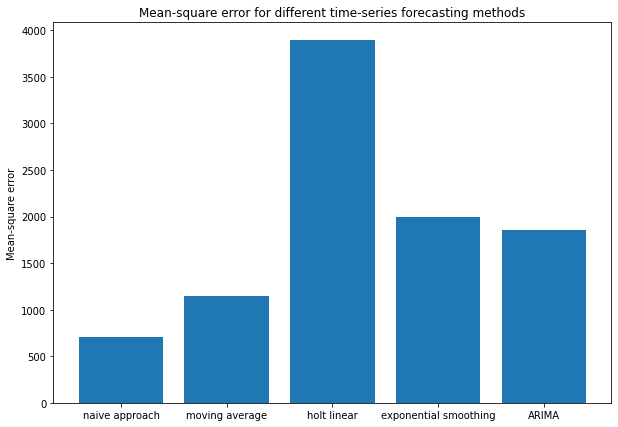

In [ ]:
errors = [error_naive, error_avg, error_holt, error_exponential, error_arima]
methods = ['naive approach', 'moving average', 'holt linear', 'exponential smoothing', 'ARIMA']
fig, ax = plt.subplots(figsize=(10,7))
x_pos = np.arange(len(methods))
ax.bar(x_pos, errors)
ax.set_xticks(x_pos)
ax.set_xticklabels(methods)
ax.set_ylabel('Mean-square error')
ax.set_title('Mean-square error for different time-series forecasting methods')
plt.show()

# time_series_covid_19_deaths

lets see sample data first to make the visual of the predictions better 

In [ ]:
train_dataset = pd.read_csv('/content/drive/MyDrive/covid_2/time_series_covid_19_deaths.csv')
drop_clo = ['Province/State','Country/Region','Lat','Long']
train_dataset=train_dataset.drop(drop_clo,axis=1)
datewise= list(train_dataset.columns)
val_dataset = train_dataset[datewise[-30:]]

In [ ]:
train_dataset.drop(columns = train_dataset.columns[:100], axis = 1, inplace = True)
train_dataset

,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20,5/10/20,...,5/20/21,5/21/21,5/22/21,5/23/21,5/24/21,5/25/21,5/26/21,5/27/21,5/28/21,5/29/21
0,68,72,85,90,95,104,106,109,115,120,...,2772,2782,2792,2802,2812,2836,2855,2869,2881,2899
1,31,31,31,31,31,31,31,31,31,31,...,2440,2441,2442,2444,2445,2447,2447,2447,2448,2449
2,453,459,463,465,470,476,483,488,494,502,...,3401,3405,3411,3418,3426,3433,3440,3448,3455,3460
3,43,44,45,45,46,46,47,47,48,48,...,127,127,127,127,127,127,127,127,127,127
4,2,2,2,2,2,2,2,2,2,2,...,704,709,715,725,731,735,742,745,749,757
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
271,0,0,0,0,0,0,0,0,0,0,...,39,41,42,43,44,44,45,46,47,47
272,2,2,2,2,2,2,2,2,2,2,...,3448,3452,3459,3459,3470,3480,3483,3483,3489,3492
273,2,2,2,2,3,5,5,5,7,8,...,1301,1302,1304,1307,1310,1311,1313,1315,1316,1319
274,3,3,3,3,3,4,4,4,7,7,...,1265,1266,1267,1268,1271,1271,1273,1275,1275,1276


In [ ]:
fig = make_subplots(rows=3, cols=1)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines+markers', y=train_dataset.loc[0].values, marker=dict(color="dodgerblue"), showlegend=False,),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[0].values, mode='lines+markers', marker=dict(color="darkorange"), showlegend=False,),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines+markers', y=train_dataset.loc[1].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[1].values, mode='lines+markers', marker=dict(color="darkorange"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines+markers', y=train_dataset.loc[2].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[2].values, mode='lines+markers', marker=dict(color="darkorange"), showlegend=False),
    row=3, col=1
)

fig.update_layout(height=1200, width=800, title_text="Train (blue) vs. Validation (orange) sales")
fig.show()

## Naive approach <a id="3.2"></a>:

In [ ]:
predictions = []
for i in range(len(val_dataset.columns)):
    if i == 0:
        predictions.append(train_dataset[train_dataset.columns[-1]].values)
    else:
        predictions.append(val_dataset[val_dataset.columns[i-1]].values)
    
predictions = np.transpose(np.array([row.tolist() for row in predictions]))
error_naive = np.linalg.norm(predictions[:3] - val_dataset.values[:3])/len(predictions[0])

In [ ]:
pred_1 = predictions[0]
pred_2 = predictions[1]
pred_3 = predictions[2]

fig = make_subplots(rows=3, cols=1)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[0].values, marker=dict(color="dodgerblue"),
               name="Train"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[0].values, mode='lines', marker=dict(color="darkorange"),
               name="Val"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_1, mode='lines', marker=dict(color="seagreen"),
               name="Pred"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[1].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[1].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_2, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[2].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[2].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_3, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=3, col=1
)

fig.update_layout(height=1200, width=800, title_text="Naive approach")
fig.show()

## Moving average <a id="3.3"></a>:

In [ ]:
predictions = []
for i in range(len(val_dataset.columns)):
    if i == 0:
        predictions.append(np.mean(train_dataset[train_dataset.columns[-30:]].values, axis=1))
    if i < 31 and i > 0:
        predictions.append(0.5 * (np.mean(train_dataset[train_dataset.columns[-30+i:]].values, axis=1) + \
                                  np.mean(predictions[:i], axis=0)))
    if i > 31:
        predictions.append(np.mean([predictions[:i]], axis=1))
    
predictions = np.transpose(np.array([row.tolist() for row in predictions]))
error_avg = np.linalg.norm(predictions[:3] - val_dataset.values[:3])/len(predictions[0])

In [ ]:
pred_1 = predictions[0]
pred_2 = predictions[1]
pred_3 = predictions[2]

fig = make_subplots(rows=3, cols=1)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[0].values, marker=dict(color="dodgerblue"),
               name="Train"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[0].values, mode='lines', marker=dict(color="darkorange"),
               name="Val"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_1, mode='lines', marker=dict(color="seagreen"),
               name="Pred"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[1].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[1].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_2, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[2].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[2].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_3, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=3, col=1
)

fig.update_layout(height=1200, width=800, title_text="Moving average")
fig.show()

# time_series_covid_19_recovered

lets see sample data first to make the visual of the predictions better 

In [ ]:
train_dataset = pd.read_csv('/content/drive/MyDrive/covid_2/time_series_covid_19_recovered.csv')
drop_clo = ['Province/State','Country/Region','Lat','Long']
train_dataset=train_dataset.drop(drop_clo,axis=1)
datewise= list(train_dataset.columns)
val_dataset = train_dataset[datewise[-30:]]

In [ ]:
train_dataset.drop(columns = train_dataset.columns[:100], axis = 1, inplace = True)
train_dataset

,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20,5/10/20,...,5/20/21,5/21/21,5/22/21,5/23/21,5/24/21,5/25/21,5/26/21,5/27/21,5/28/21,5/29/21
0,310,331,345,397,421,458,468,472,502,558,...,55687,55790,55889,56035,56295,56518,56711,56962,57119,57281
1,488,519,531,543,570,595,605,620,627,650,...,127869,128425,128601,128732,128826,128907,128978,129042,129097,129215
2,1821,1872,1936,1998,2067,2197,2323,2467,2546,2678,...,87902,88066,88208,88346,88497,88672,88861,89040,89232,89419
3,468,472,493,499,514,521,526,537,545,550,...,13234,13234,13234,13234,13234,13263,13381,13405,13416,13416
4,11,11,11,11,11,11,11,11,13,13,...,26483,26513,26775,26778,27087,27204,27467,27529,27577,27646
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
256,219,219,219,219,232,232,233,241,241,241,...,2687,2689,2721,2721,2794,2794,2853,2853,2896,2896
257,76,76,77,102,127,174,176,228,228,263,...,295643,296901,297201,297201,298502,299024,299559,299559,300125,300524
258,1,1,1,1,1,1,1,1,1,1,...,3159,3179,3201,3245,3260,3273,3306,3339,3375,3399
259,74,75,78,78,92,101,103,111,112,117,...,90955,91019,91102,91156,91200,91221,91239,91321,91443,91594


In [ ]:
fig = make_subplots(rows=3, cols=1)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines+markers', y=train_dataset.loc[0].values, marker=dict(color="dodgerblue"), showlegend=False,),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[0].values, mode='lines+markers', marker=dict(color="darkorange"), showlegend=False,),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines+markers', y=train_dataset.loc[1].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[1].values, mode='lines+markers', marker=dict(color="darkorange"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines+markers', y=train_dataset.loc[2].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[2].values, mode='lines+markers', marker=dict(color="darkorange"), showlegend=False),
    row=3, col=1
)

fig.update_layout(height=1200, width=800, title_text="Train (blue) vs. Validation (orange) sales")
fig.show()

## Naive approach <a id="3.2"></a>:

In [ ]:
predictions = []
for i in range(len(val_dataset.columns)):
    if i == 0:
        predictions.append(train_dataset[train_dataset.columns[-1]].values)
    else:
        predictions.append(val_dataset[val_dataset.columns[i-1]].values)
    
predictions = np.transpose(np.array([row.tolist() for row in predictions]))
error_naive = np.linalg.norm(predictions[:3] - val_dataset.values[:3])/len(predictions[0])

In [ ]:
pred_1 = predictions[0]
pred_2 = predictions[1]
pred_3 = predictions[2]

fig = make_subplots(rows=3, cols=1)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[0].values, marker=dict(color="dodgerblue"),
               name="Train"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[0].values, mode='lines', marker=dict(color="darkorange"),
               name="Val"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_1, mode='lines', marker=dict(color="seagreen"),
               name="Pred"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[1].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[1].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_2, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[2].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[2].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_3, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=3, col=1
)

fig.update_layout(height=1200, width=800, title_text="Naive approach")
fig.show()

## Moving average <a id="3.3"></a>:

In [ ]:
predictions = []
for i in range(len(val_dataset.columns)):
    if i == 0:
        predictions.append(np.mean(train_dataset[train_dataset.columns[-30:]].values, axis=1))
    if i < 31 and i > 0:
        predictions.append(0.5 * (np.mean(train_dataset[train_dataset.columns[-30+i:]].values, axis=1) + \
                                  np.mean(predictions[:i], axis=0)))
    if i > 31:
        predictions.append(np.mean([predictions[:i]], axis=1))
    
predictions = np.transpose(np.array([row.tolist() for row in predictions]))
error_avg = np.linalg.norm(predictions[:3] - val_dataset.values[:3])/len(predictions[0])

In [ ]:
pred_1 = predictions[0]
pred_2 = predictions[1]
pred_3 = predictions[2]

fig = make_subplots(rows=3, cols=1)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[0].values, marker=dict(color="dodgerblue"),
               name="Train"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[0].values, mode='lines', marker=dict(color="darkorange"),
               name="Val"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_1, mode='lines', marker=dict(color="seagreen"),
               name="Pred"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[1].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[1].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_2, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=2, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140), mode='lines', y=train_dataset.loc[2].values, marker=dict(color="dodgerblue"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=val_dataset.loc[2].values, mode='lines', marker=dict(color="darkorange"), showlegend=False),
    row=3, col=1
)

fig.add_trace(
    go.Scatter(x=np.arange(140,200), y=pred_3, mode='lines', marker=dict(color="seagreen"), showlegend=False,
               name="Denoised signal"),
    row=3, col=1
)

fig.update_layout(height=1200, width=800, title_text="Moving average")
fig.show()

## Comparison with similar Disease

In [ ]:
full_latest_grouped = cleaned_data.groupby('Country/Region')['Confirmed', 'Deaths', 'Recovered', 'Active'].sum().reset_index()
epidemics = pd.DataFrame({
    'epidemic' : ['COVID-19', 'SARS', 'EBOLA', 'MERS', 'H1N1'],
    'start_year' : [2019, 2003, 2014, 2012, 2009],
    'end_year' : [2020, 2004, 2016, 2017, 2010],
    'confirmed' : [full_latest_grouped['Confirmed'].sum(), 8096, 28646, 2494, 6724149],
    'deaths' : [full_latest_grouped['Deaths'].sum(), 774, 11323, 858, 19654]
})

epidemics['mortality'] = round((epidemics['deaths']/epidemics['confirmed'])*100, 2)

epidemics.head()

,epidemic,start_year,end_year,confirmed,deaths,mortality
0,COVID-19,2019,2020,828508482,43384903,5.24
1,SARS,2003,2004,8096,774,9.56
2,EBOLA,2014,2016,28646,11323,39.53
3,MERS,2012,2017,2494,858,34.40
4,H1N1,2009,2010,6724149,19654,0.29


In [ ]:
temp = epidemics.melt(id_vars='epidemic', value_vars=['confirmed', 'deaths', 'mortality'],
                      var_name='Case', value_name='Value')

fig = px.bar(temp, x="epidemic", y="Value", color='epidemic', text='Value', facet_col="Case",
             color_discrete_sequence = px.colors.qualitative.Bold)
fig.update_traces(textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.update_yaxes(showticklabels=False)
fig.layout.yaxis2.update(matches=None)
fig.layout.yaxis3.update(matches=None)
fig.show()